###### exteend the training dataset to cover release_8 ,release_4 which they are parallel

## Pre-processing ##
Now that everything is set up, we want to load our data, but first we need to load a couple of useful python packages:


In [2]:
from sys import stdout

import random
import numpy as np

import matplotlib.pyplot as plt

from PIL import Image

import keras
import keras.backend as K

In [3]:
from segments import SegmentsClient, SegmentsDataset
from segments.utils import export_dataset
from segments.utils import get_semantic_bitmap

# load and plot dataset from segments.ai

In [4]:
client = SegmentsClient('3d2505cf0a95d64eabb333d76ecb472bcca6a456')
dataset_name_n = 'ayda/faullt_8'
dataset_name_1 = 'ayda/faul_1_new'
dataset_name_2 = 'ayda/fault_2'
dataset_name_3 = 'ayda/fault_3'
dataset_name_4 = 'ayda/fault_4'
dataset_name_5 = 'ayda/fault_5'
dataset_name_7 = 'ayda/fault_7'


# Get a list of image URLs
release_n = client.get_release(dataset_name_n, 'fault_13.a') 
release_1 = client.get_release(dataset_name_1, 'fault_1') 
release_2 = client.get_release(dataset_name_2, 'fault_2') 
release_3 = client.get_release(dataset_name_3, 'fault_3')
release_4 = client.get_release(dataset_name_4, 'fault_4')
release_5 = client.get_release(dataset_name_5, 'fault_5')
release_7 = client.get_release(dataset_name_7, 'fault_7')

## loading data and lable then show together

Initializing dataset...
Preloading all samples. This may take a while...


100%|███████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 106.75it/s]

Initialized dataset with 9 images.


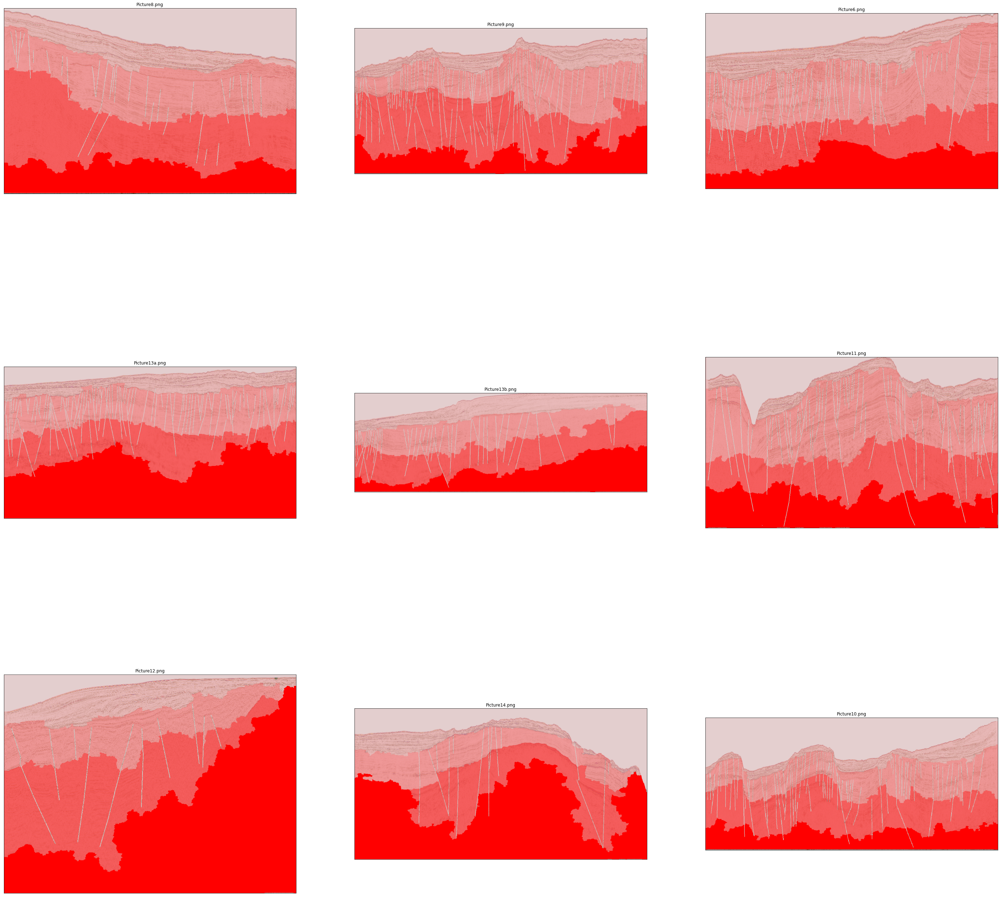

In [5]:
# from google.colab import widgets

def load_data_label(sample):

    label = get_semantic_bitmap(sample['segmentation_bitmap'], sample['annotations'])
    data = np.asarray(sample['image']) / 255.
    #converting to grayscale
#         data = 0.2989*data[:,:,0] + 0.5870*data[:,:,1] + 0.1140*data[:,:,2]
#         data = Image.open(data_dir + sample['file_name'])
    label = np.asarray(label)
    return data, label


def plot_overlay(image, label, i):
    (tmax, xmax) = np.shape(label)

    label_rgb = np.zeros((tmax,xmax,4), 'uint8')
    label_rgb[:,:,0] = 255
    label_rgb[:,:,1] = 255 - 255*label/np.max(label)
    label_rgb[:,:,2] = 255 - 255*label/np.max(label)
    label_rgb[:,:,3] = 255*label/np.max(label)   
    
    img = Image.fromarray(label_rgb, mode='RGBA')
    
#     img_gray = 0.2989*image[:,:,0] + 0.5870*image[:,:,1] + 0.1140*image[:,:,2]
    image_rgb = np.zeros((tmax,xmax,4), 'uint8')    
    image_rgb[:,:,0] = 255*image[:,:,0]
    image_rgb[:,:,1] = 255*image[:,:,1]
    image_rgb[:,:,2] = 255*image[:,:,2]
#     image_rgb[:,:,0:3] = 255. * image
    image_rgb[:,:,3] = 255
    
    background = Image.fromarray(image_rgb, mode='RGBA') 
    background.paste(img, (0, 0), img)

#     background = Image.fromarray(image_rgb, mode='RGBA') 
#     print(image.shape)
#     print(label.shape)
#     background.paste(label, (0, 0), label)

    plt.subplot(3,3,i+1).imshow(background)
    plt.title(sample['file_name'])
    plt.xticks([])
    plt.yticks([])



release = [release_n]
plt.figure(figsize=(50,50))
dataset = SegmentsDataset(release_n)
for i, sample in enumerate(dataset): 
    data, label = load_data_label(sample)
    
    plot_overlay(data, label, i)
#     plt.subplot(1,3,i+1).xticks([])
#     plt.yticks([])

Initializing dataset...
Preloading all samples. This may take a while...


100%|███████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 139.15it/s]

Initialized dataset with 9 images.


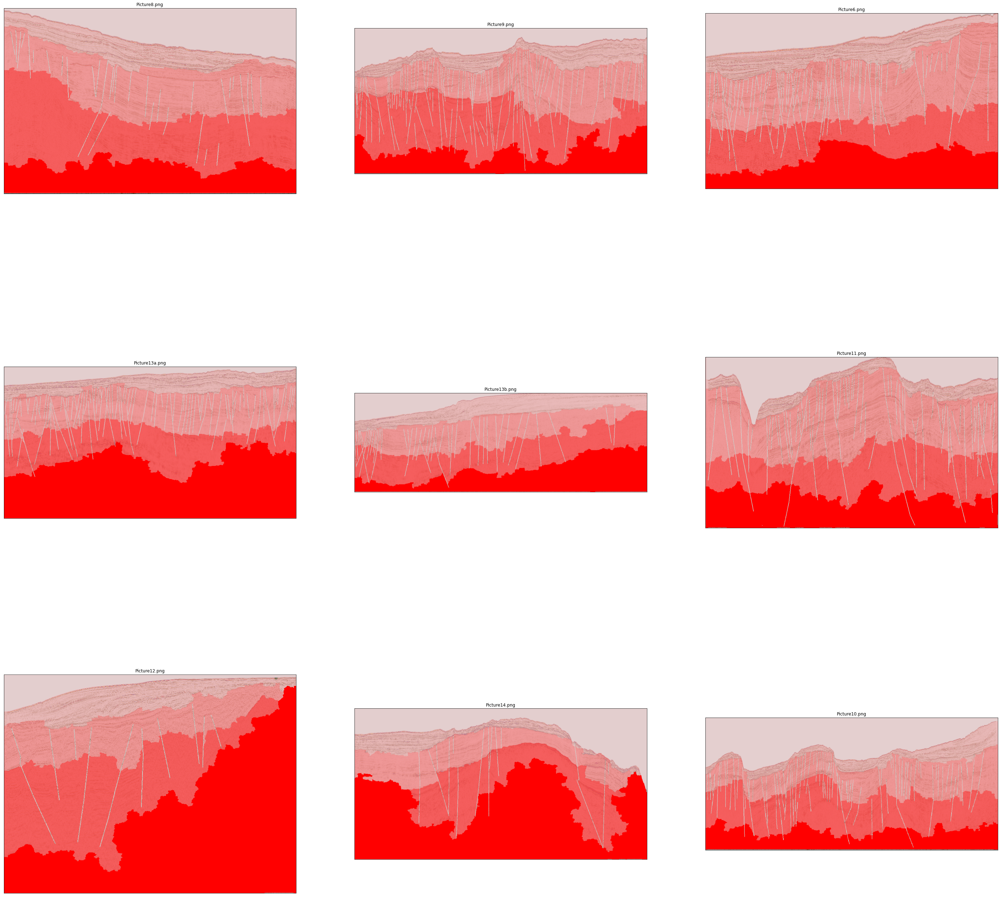

In [6]:
# from google.colab import widgets

def load_data_label(sample):

    label = get_semantic_bitmap(sample['segmentation_bitmap'], sample['annotations'])
    data = np.asarray(sample['image']) / 255.
    #converting to grayscale
#         data = 0.2989*data[:,:,0] + 0.5870*data[:,:,1] + 0.1140*data[:,:,2]
#         data = Image.open(data_dir + sample['file_name'])
    label = np.asarray(label)
    return data, label



release = [release_1]
plt.figure(figsize=(50,50))
dataset = SegmentsDataset(release_n)
for i, sample in enumerate(dataset): 
    data, label = load_data_label(sample)
    
    plot_overlay(data, label, i)
#     plt.subplot(1,3,i+1).xticks([])
#     plt.yticks([])

In [7]:
def load_data_label(release):
    dataset = SegmentsDataset(release)
    for sample in dataset:
        label = get_semantic_bitmap(sample['segmentation_bitmap'], sample['annotations'])
        label = np.stack([label==v for v in np.unique(label)], axis=-1)
        data = np.asarray(sample['image']) / 255.
        #converting to grayscale
#         data = 0.2989*data[:,:,0] + 0.5870*data[:,:,1] + 0.1140*data[:,:,2]
#         data = Image.open(data_dir + sample['file_name'])
    label = np.asarray(label)
    return data, label


def patchify(data, label, size, number, seg):

    (t_max, x_max, _) = label.shape    
        
    n = 0
    X = np.zeros((number,size,size,3))
    Y = np.zeros((number,size,size,1))
    
    for t in range(size//2+1, t_max-size//2, 10):
        for x in range(size//2+1, x_max-size//2, 10):
            if n<number and np.count_nonzero(label[t-size//2:t+size//2, x-size//2:x+size//2, seg]) > threshold:
                X[n, ...] = data[t-size//2:t+size//2, x-size//2:x+size//2, :]
                Y[n, :,:,0] = label[t-size//2:t+size//2, x-size//2:x+size//2, 1]
                n = n + 1
            
    return X, Y


# Parameters
size       = 64
s          = size//2
threshold  = 10
stride     = 10
num_val    = 2000
np.random.seed(100)

# Validation data from inline 300
X_val = np.zeros((num_val,size,size,3))
Y_val = np.zeros((num_val,size,size,1))

seg = [3,4]

n = 0
release_list = [release_1]
for i, release in enumerate(release_list):
    seismic, label = load_data_label(release)
    Num = np.sum(label[s:-s:stride,s:-s:stride, seg[i]])
    X_val[n:n+num_val,...], Y_val[n:n+num_val,...] = patchify(seismic[:,:,:3], label, size, num_val, seg[i]) 
    n += num_val

# Training data from inlines 

release_list = [release_2, release_3, release_4, release_5, release_7, release_n]
seg = [3,4]

n = 0
num_train = []
for i, release in enumerate(release_list):
    seismic, label = load_data_label(release)
    Num += int(np.sum(label[s:-s:stride,s:-s:stride,seg[0]])//stride) + int(np.sum(label[s:-s:stride,s:-s:stride,seg[1]])//stride)
    num_train.append(Num)

X_train = np.zeros((Num,size,size,3))
Y_train = np.zeros((Num,size,size,1))

for s_i in seg:
    for i, release in enumerate(release_list):
        seismic, label = load_data_label(release)
        X_train[n:n+num_train[i],...], Y_train[n:n+num_train[i],...] = patchify(seismic[:,:,:3], label, size, num_train[i], s_i) 

def load_data_label(sample):

    label = get_semantic_bitmap(sample['segmentation_bitmap'], sample['annotations'])
    label = np.stack([label==v for v in np.unique(label)], axis=-1)
    data = np.asarray(sample['image']) / 255.

    return data, label

dataset = SegmentsDataset(release_n)

for s_i in seg:
    for sample in dataset:
        seismic, label = load_data_label(sample)
        Num = np.sum(label[s:-s:stride,s:-s:stride,s_i])
        X_temp, Y_temp = patchify(seismic[:,:,:3], label, size, Num, s_i) 
        X_train = np.concatenate((X_train, X_temp), axis=0)
        Y_train = np.concatenate((Y_train, Y_temp), axis=0)

Initializing dataset...
Preloading all samples. This may take a while...


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 70.88it/s]

Initialized dataset with 1 images.


Initializing dataset...
Preloading all samples. This may take a while...


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 50.58it/s]

Initialized dataset with 1 images.


Initializing dataset...
Preloading all samples. This may take a while...


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 37.18it/s]

Initialized dataset with 1 images.


Initializing dataset...
Preloading all samples. This may take a while...


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 43.45it/s]

Initialized dataset with 1 images.


Initializing dataset...
Preloading all samples. This may take a while...


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 29.94it/s]

Initialized dataset with 1 images.


Initializing dataset...
Preloading all samples. This may take a while...


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 30.66it/s]

Initialized dataset with 1 images.


Initializing dataset...
Preloading all samples. This may take a while...


100%|███████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 184.50it/s]

Initialized dataset with 9 images.


Initializing dataset...
Preloading all samples. This may take a while...


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 28.06it/s]

Initialized dataset with 1 images.


Initializing dataset...
Preloading all samples. This may take a while...


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 29.67it/s]

Initialized dataset with 1 images.


Initializing dataset...
Preloading all samples. This may take a while...


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 56.70it/s]

Initialized dataset with 1 images.


Initializing dataset...
Preloading all samples. This may take a while...


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 56.10it/s]

Initialized dataset with 1 images.


Initializing dataset...
Preloading all samples. This may take a while...


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 19.76it/s]

Initialized dataset with 1 images.


Initializing dataset...
Preloading all samples. This may take a while...


100%|███████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 113.58it/s]

Initialized dataset with 9 images.


Initializing dataset...
Preloading all samples. This may take a while...


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 71.23it/s]

Initialized dataset with 1 images.


Initializing dataset...
Preloading all samples. This may take a while...


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 63.76it/s]

Initialized dataset with 1 images.


Initializing dataset...
Preloading all samples. This may take a while...


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 58.88it/s]

Initialized dataset with 1 images.


Initializing dataset...
Preloading all samples. This may take a while...


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 35.43it/s]

Initialized dataset with 1 images.


Initializing dataset...
Preloading all samples. This may take a while...


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 30.99it/s]

Initialized dataset with 1 images.


Initializing dataset...
Preloading all samples. This may take a while...


100%|███████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 154.74it/s]

Initialized dataset with 9 images.


Initializing dataset...
Preloading all samples. This may take a while...


100%|███████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 162.31it/s]

Initialized dataset with 9 images.


Before training, it's always a good idea to check the training data, so let's do that:

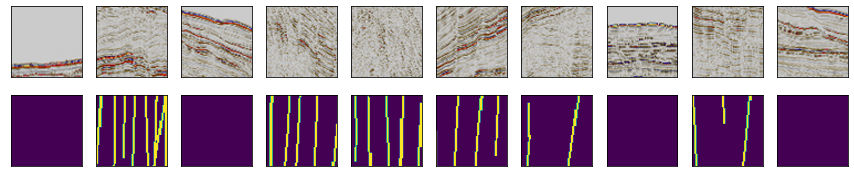

In [20]:
fig, axs = plt.subplots(2, 10, figsize=(15,3))

K = []
for m in range(10):
    k = random.randint(0,4000)
    K.append(k)
    axs[0,m].imshow(X_train[k], interpolation='spline16', cmap=plt.cm.gray, aspect=1)
    axs[0,m].set_xticks([])
    axs[0,m].set_yticks([])

# K = np.stack(K)
for m in range(10):
    axs[1,m].imshow(Y_train[K[m]], interpolation='spline16', aspect=1)
    axs[1,m].set_xticks([])
    axs[1,m].set_yticks([])
    k += 1


What do you notice?

* Is it an easy task?
* Could you predict the masks?
* Can we learn more from some examples?

## Training ##
To train our model, we need to define its architecture. 



In [8]:
def down_block(x, filters, kernel_size=(3, 3), padding="same", strides=1):
    c = keras.layers.Conv2D(filters, kernel_size, padding=padding, strides=strides, activation="relu")(x)
    c = keras.layers.Conv2D(filters, kernel_size, padding=padding, strides=strides, activation="relu")(c)
    p = keras.layers.MaxPool2D((2, 2), (2, 2))(c)
    return c, p

def up_block(x, skip, filters, kernel_size=(3, 3), padding="same", strides=1):
    us = keras.layers.UpSampling2D((2, 2))(x)
    concat = keras.layers.Concatenate()([us, skip])
    c = keras.layers.Conv2D(filters, kernel_size, padding=padding, strides=strides, activation="relu")(concat)
    c = keras.layers.Conv2D(filters, kernel_size, padding=padding, strides=strides, activation="relu")(c)
    return c

def bottleneck(x, filters, kernel_size=(3, 3), padding="same", strides=1):
    c = keras.layers.Conv2D(filters, kernel_size, padding=padding, strides=strides, activation="relu")(x)
    c = keras.layers.Conv2D(filters, kernel_size, padding=padding, strides=strides, activation="relu")(c)
    return c

def UNet():
    f = [16, 32, 64, 128, 256]
    inputs = keras.layers.Input((size, size, 3))

    p0 = inputs
    c1, p1 = down_block(p0, f[0]) #128 -> 64
    c2, p2 = down_block(p1, f[1]) #64 -> 32
    c3, p3 = down_block(p2, f[2]) #32 -> 16
    c4, p4 = down_block(p3, f[3]) #16->8

    bn = bottleneck(p4, f[4])

    u1 = up_block(bn, c4, f[3]) #8 -> 16
    u2 = up_block(u1, c3, f[2]) #16 -> 32
    u3 = up_block(u2, c2, f[1]) #32 -> 64
    u4 = up_block(u3, c1, f[0]) #64 -> 128
    outputs = keras.layers.Conv2D(1, (1, 1), padding="same", activation="sigmoid")(u4)

    model = keras.models.Model(inputs, outputs)
    return model

size = 64
# model = UNet()
import segmentation_models as sm

model = sm.Unet('mobilenet', classes=1, activation='sigmoid', decoder_filters=(64, 32, 32, 16, 4))
model.compile(optimizer="Adam", loss='binary_crossentropy', metrics=['acc'])

model.summary()

Segmentation Models: using `keras` framework.


C:\Users\aazadkhorasa\AppData\Roaming\Python\Python39\site-packages\keras_applications\mobilenet.py:207: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  warnings.warn('`input_shape` is undefined or non-square, '


Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, None, None,   0           ['input_1[0][0]']                
                                3)                                                                
                                                                                                  
 conv1 (Conv2D)                 (None, None, None,   864         ['conv1_pad[0][0]']              
                                32)                                                           

                                                                                                  
 conv_dw_4_relu (ReLU)          (None, None, None,   0           ['conv_dw_4_bn[0][0]']           
                                128)                                                              
                                                                                                  
 conv_pw_4 (Conv2D)             (None, None, None,   32768       ['conv_dw_4_relu[0][0]']         
                                256)                                                              
                                                                                                  
 conv_pw_4_bn (BatchNormalizati  (None, None, None,   1024       ['conv_pw_4[0][0]']              
 on)                            256)                                                              
                                                                                                  
 conv_pw_4

 on)                            512)                                                              
                                                                                                  
 conv_pw_8_relu (ReLU)          (None, None, None,   0           ['conv_pw_8_bn[0][0]']           
                                512)                                                              
                                                                                                  
 conv_dw_9 (DepthwiseConv2D)    (None, None, None,   4608        ['conv_pw_8_relu[0][0]']         
                                512)                                                              
                                                                                                  
 conv_dw_9_bn (BatchNormalizati  (None, None, None,   2048       ['conv_dw_9[0][0]']              
 on)                            512)                                                              
          

 conv_dw_13_bn (BatchNormalizat  (None, None, None,   4096       ['conv_dw_13[0][0]']             
 ion)                           1024)                                                             
                                                                                                  
 conv_dw_13_relu (ReLU)         (None, None, None,   0           ['conv_dw_13_bn[0][0]']          
                                1024)                                                             
                                                                                                  
 conv_pw_13 (Conv2D)            (None, None, None,   1048576     ['conv_dw_13_relu[0][0]']        
                                1024)                                                             
                                                                                                  
 conv_pw_13_bn (BatchNormalizat  (None, None, None,   4096       ['conv_pw_13[0][0]']             
 ion)     

                                                                                                  
 decoder_stage2b_bn (BatchNorma  (None, None, None,   128        ['decoder_stage2b_conv[0][0]']   
 lization)                      32)                                                               
                                                                                                  
 decoder_stage2b_relu (Activati  (None, None, None,   0          ['decoder_stage2b_bn[0][0]']     
 on)                            32)                                                               
                                                                                                  
 decoder_stage3_upsampling (UpS  (None, None, None,   0          ['decoder_stage2b_relu[0][0]']   
 ampling2D)                     32)                                                               
                                                                                                  
 decoder_s

# Now you can train your convolutional neural net using the data generator:
##I increased epochs rank!(30 times my model was trained)

In [22]:
from keras.callbacks import CSVLogger
csvlogger = CSVLogger('history_26_Dec_clu_BCE.csv', append=True)
history = model.fit(X_train, 
                    Y_train, 
                    batch_size=32,
                    validation_data=(X_val, Y_val), 
                    epochs=50,
                    callbacks=[csvlogger])

model.save('checkpoint_tot3_26_Dec_clu_BCE')

Epoch 1/50
686/686 [==============================] - 33s 37ms/step - loss: 0.5929 - acc: 0.8966 - val_loss: 0.4483 - val_acc: 0.9823
Epoch 2/50
686/686 [==============================] - 24s 36ms/step - loss: 0.3925 - acc: 0.9557 - val_loss: 0.3041 - val_acc: 0.9823
Epoch 3/50
686/686 [==============================] - 24s 36ms/step - loss: 0.2946 - acc: 0.9557 - val_loss: 0.2216 - val_acc: 0.9823
Epoch 4/50
686/686 [==============================] - 24s 36ms/step - loss: 0.2411 - acc: 0.9557 - val_loss: 0.1728 - val_acc: 0.9823
Epoch 5/50
686/686 [==============================] - 24s 36ms/step - loss: 0.2117 - acc: 0.9557 - val_loss: 0.1433 - val_acc: 0.9823
Epoch 6/50
686/686 [==============================] - 24s 36ms/step - loss: 0.1958 - acc: 0.9557 - val_loss: 0.1250 - val_acc: 0.9823
Epoch 7/50
686/686 [==============================] - 24s 36ms/step - loss: 0.1875 - acc: 0.9557 - val_loss: 0.1137 - val_acc: 0.9823
Epoch 8/50
686/686 [==============================] - 24s 36ms

INFO:tensorflow:Assets written to: checkpoint_tot3_26_Dec_clu_BCE\assets


INFO:tensorflow:Assets written to: checkpoint_tot3_26_Dec_clu_BCE\assets


To visualize our training, you can plot learning curves:

In [9]:
model.load_weights('checkpoint_tot3_26_Dec_clu_BCE')

In [24]:
import pandas as pd
history = pd.read_csv('history_26_Dec_clu_BCE.csv')

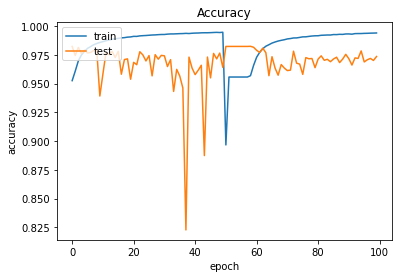

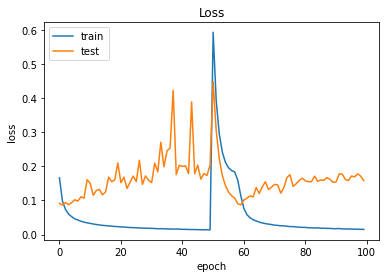

In [25]:
plt.plot(history['acc'])
plt.plot(history['val_acc'])
plt.title('Accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.plot(history['loss'])
plt.plot(history['val_loss'])
plt.title('Loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [10]:
from keras import backend as K

def F1_score(y_true, y_pred, smooth=1):
    intersection = K.sum(y_true * y_pred, axis=[1,2,3])
    union = K.sum(y_true, axis=[1,2,3]) + K.sum(y_pred, axis=[1,2,3])
    dice = K.mean((2. * intersection + smooth)/(union + smooth), axis=0)
    return dice

In [11]:
y_pred = model.predict(X_val)
Y_pred = 1. * (y_pred>0.5)
Y_true = Y_val

print(F1_score(Y_true, Y_pred).numpy())


63/63 [==============================] - 5s 13ms/step
0.23683271894880567


and a confusion matrix:

In [12]:
from sklearn.metrics import confusion_matrix

Y_pred = model.predict(X_val)
Y_true = Y_val    

cm = np.zeros((2,2))

for n in range(Y_true.shape[0]):

  y_true = Y_true[n, ...].round().flatten()
  y_pred = Y_pred[n, ...].round().flatten()

  cm_batch = confusion_matrix(y_true, y_pred)
              

  cm = cm + cm_batch

63/63 [==============================] - 1s 16ms/step


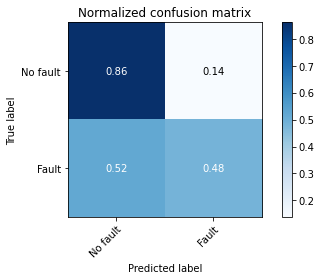

In [13]:
cmap=plt.cm.Blues
normalize = True

title = 'Normalized confusion matrix'


# Only use the labels that appear in the data
classes = ['No fault','Fault']

# Normalize
cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


fig, ax = plt.subplots()
im = ax.imshow(cm_norm, interpolation='nearest', cmap=cmap)
ax.figure.colorbar(im, ax=ax)
# We want to show all ticks...
ax.set(xticks=np.arange(cm_norm.shape[1]),
       yticks=np.arange(cm_norm.shape[0]),
       # ... and label them with the respective list entries
       xticklabels=classes, yticklabels=classes,
       title=title,
       ylabel='True label',
       xlabel='Predicted label')

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
         rotation_mode="anchor")

# Loop over data dimensions and create text annotations.
fmt = '.2f' if normalize else 'd'
thresh = cm_norm.max() / 2.
for i in range(cm_norm.shape[0]):
    for j in range(cm_norm.shape[1]):
        ax.text(j, i, format(cm_norm[i, j], fmt),
                ha="center", va='center',
                color="white" if cm_norm[i, j] > thresh else "black")
fig.tight_layout()

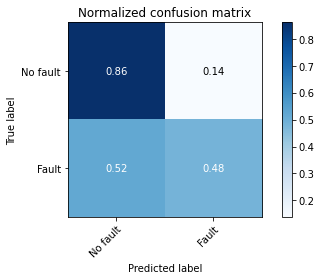

In [29]:
cmap=plt.cm.Blues
normalize = True

title = 'Normalized confusion matrix'


# Only use the labels that appear in the data
classes = ['No fault','Fault']

# Normalize
cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


fig, ax = plt.subplots()
im = ax.imshow(cm_norm, interpolation='nearest', cmap=cmap)
ax.figure.colorbar(im, ax=ax)
# We want to show all ticks...
ax.set(xticks=np.arange(cm_norm.shape[1]),
       yticks=np.arange(cm_norm.shape[0]),
       # ... and label them with the respective list entries
       xticklabels=classes, yticklabels=classes,
       title=title,
       ylabel='True label',
       xlabel='Predicted label')

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
         rotation_mode="anchor")

# Loop over data dimensions and create text annotations.
fmt = '.2f' if normalize else 'd'
thresh = cm_norm.max() / 2.
for i in range(cm_norm.shape[0]):
    for j in range(cm_norm.shape[1]):
        ax.text(j, i, format(cm_norm[i, j], fmt),
                ha="center", va='center',
                color="white" if cm_norm[i, j] > thresh else "black")
fig.tight_layout()

## Application##
Now we can apply our model to the entire image to see how well it has learned to recognize salt structures in our seismic image:

In [14]:
def tile(data, label, wsize, dt, dx, seg):
    
    (t_max, x_max, _) = data.shape    
    
    n_patch = (t_max//dt+1)*(x_max//dx+1)
    data_patch = np.zeros((n_patch,wsize,wsize,3)) 

    n = 0
    T = []
    N = []
    for t in range(0, t_max, dt):
        for x in range(0, x_max, dx):  
            if label[t,x,seg[0]] or label[t,x,seg[1]] or label[t,x,seg[2]]:
                T.append([t,x])

                if t_max - t < wsize and x_max - x < wsize:
                    data_patch[n,:,:,:] = data[t_max-wsize:t_max, x_max-wsize:x_max,:3]
                elif x_max - x < wsize:
                    data_patch[n,:,:,:] = data[t:t+wsize, x_max-wsize:x_max,:3]
                elif t_max - t < wsize:
                    data_patch[n,:,:,:] = data[t_max-wsize:t_max, x:x+wsize,:3]
                else:
                    data_patch[n,:,:,:] = data[t:t+wsize,x:x+wsize, :3]  
                N.append(n)
            n = n + 1
    return data_patch, T, N




def merge(data_patch, t_max, x_max, wsize, dt, dx, T, N):

    data_new = np.zeros((t_max, x_max,3))
    count = np.zeros((t_max, x_max, 1))
    
    n = 0
    for t,x in T:

            if t_max - t < wsize and x_max - x < wsize:
                data_new[t_max-wsize:t_max, x_max-wsize:x_max,:] += data_patch[N[n],:,:,:]
                count[t_max-wsize:t_max, x_max-wsize:x_max,0] += 1
            elif x_max - x < wsize:
                data_new[t:t+wsize, x_max-wsize:x_max,:] += data_patch[N[n],:,:,:]
                count[t:t+wsize, x_max-wsize:x_max,0] += 1 
            elif t_max - t < wsize:
                data_new[t_max-wsize:t_max, x:x+wsize,:] += data_patch[N[n],:,:,:]
                count[t_max-wsize:t_max, x:x+wsize,0] += 1
            else:
                data_new[t:t+wsize,x:x+wsize,:] += data_patch[N[n],:,:,:]
                count[t:t+wsize,x:x+wsize,0] += 1 
            
            n = n + 1

    return data_new

def plot_overlay(image, label, i):
    (tmax, xmax) = np.shape(label)

    label_rgb = np.zeros((tmax,xmax,4), 'uint8')
    label_rgb[:,:,0] = 255
    label_rgb[:,:,1] = 255 - 255*label
    label_rgb[:,:,2] = 255 - 255*label
    label_rgb[:,:,3] = 255*label   
    
    img = Image.fromarray(label_rgb, mode='RGBA')
    
    image_rgb = np.zeros((tmax,xmax,4), 'uint8')    
    image_rgb[:,:,0] = 255*image[:,:,0]
    image_rgb[:,:,1] = 255*image[:,:,1]
    image_rgb[:,:,2] = 255*image[:,:,2]
#     image_rgb[:,:,0:3] = 255. * image
    image_rgb[:,:,3] = 255
    
    background = Image.fromarray(image_rgb, mode='RGBA') 
    background.paste(img, (0, 0), img)

#     background = Image.fromarray(image_rgb, mode='RGBA') 
#     print(image.shape)
#     print(label.shape)
#     background.paste(label, (0, 0), label)

    plt.subplot(9,1,i+1).imshow(background)
    plt.xticks([])
    plt.yticks([])

def load_data_label(release):
    dataset = SegmentsDataset(release)
    for sample in dataset:
        label = get_semantic_bitmap(sample['segmentation_bitmap'], sample['annotations'])
        label = np.stack([label==v for v in np.unique(label)], axis=-1)
        data = np.asarray(sample['image']) / 255.
        #converting to grayscale
#         data = 0.2989*data[:,:,0] + 0.5870*data[:,:,1] + 0.1140*data[:,:,2]
#         data = Image.open(data_dir + sample['file_name'])
    label = np.asarray(label)
    return data, label

Initializing dataset...
Preloading all samples. This may take a while...


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 36.98it/s]

Initialized dataset with 1 images.


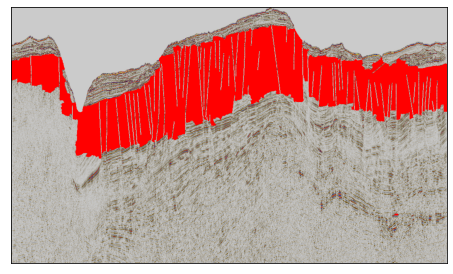

In [15]:
def load_data_label(release):
    dataset = SegmentsDataset(release)
    for sample in dataset:
        label = get_semantic_bitmap(sample['segmentation_bitmap'], sample['annotations'])
        label = np.stack([label==v for v in np.unique(label)], axis=-1)
        data = np.asarray(sample['image']) / 255.
        #converting to grayscale
#         data = 0.2989*data[:,:,0] + 0.5870*data[:,:,1] + 0.1140*data[:,:,2]
#         data = Image.open(data_dir + sample['file_name'])
    label = np.asarray(label)
    return data, label

plt.figure(figsize=(80,50))
for i, rel in enumerate([release_1]):
    
    data, label = load_data_label(rel)
    plot_overlay(data, label[:,:,4], i)
   
#     plt.xticks([])
#     plt.yticks([])

Initializing dataset...
Preloading all samples. This may take a while...


100%|███████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 155.46it/s]

Initialized dataset with 9 images.


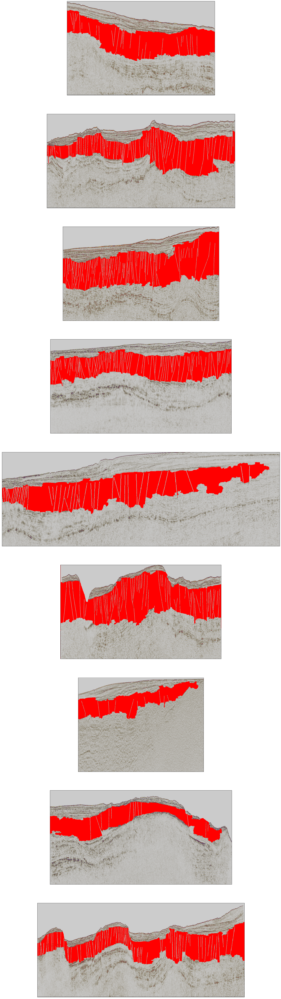

In [16]:
def load_data_label(sample):
    
    
    label = get_semantic_bitmap(sample['segmentation_bitmap'], sample['annotations'])
    label = np.stack([label==v for v in np.unique(label)], axis=-1)
    data = np.asarray(sample['image']) / 255.
    #converting to grayscale
#         data = 0.2989*data[:,:,0] + 0.5870*data[:,:,1] + 0.1140*data[:,:,2]
#         data = Image.open(data_dir + sample['file_name'])
    label = np.asarray(label)
    return data, label

plt.figure(figsize=(80,100))
dataset = SegmentsDataset(release_n)
for i, sample in enumerate(dataset):
    
    data, label = load_data_label(sample)
    plot_overlay(data, label[:,:,4], i)
#     plt.xticks([])
#     plt.yticks([])

Initializing dataset...
Preloading all samples. This may take a while...


100%|███████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 145.13it/s]

Initialized dataset with 9 images.


([], [])

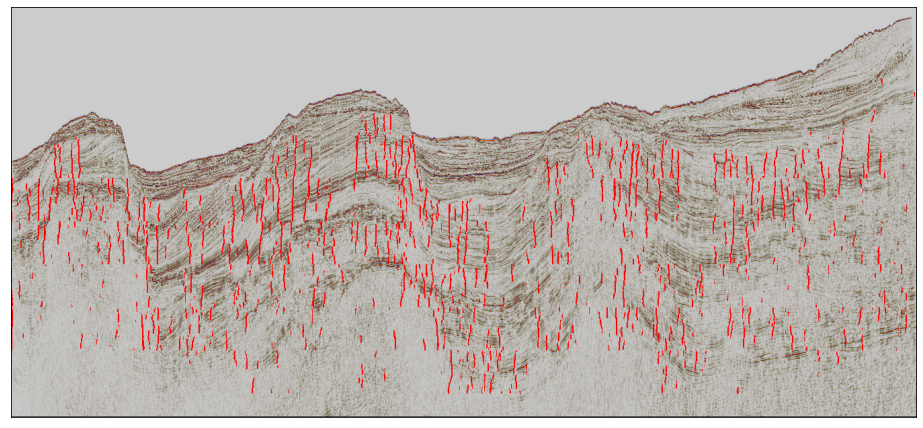

In [50]:
dt = 64
dx = 64

# data, label = load_data_label(release_3)
# data = data[:700, :800]
# lable = label[:700, :800]
def load_data_label(sample):
    
    
    label = get_semantic_bitmap(sample['segmentation_bitmap'], sample['annotations'])
    label = np.stack([label==v for v in np.unique(label)], axis=-1)
    data = np.asarray(sample['image']) / 255.
    #converting to grayscale
#         data = 0.2989*data[:,:,0] + 0.5870*data[:,:,1] + 0.1140*data[:,:,2]
#         data = Image.open(data_dir + sample['file_name'])
    label = np.asarray(label)
    return data, label

plt.figure(figsize=(100,80))
seg = [3,4,5]
    
dataset = SegmentsDataset(release_n) 
# for i, sample in enumerate(dataset):
    
data, label = load_data_label(dataset[8])
(t_max, x_max, _) = data.shape

data_tiles, T, N   = tile(data, label, size, dt, dx, seg)
result_tiles = 1.*(model.predict_on_batch(data_tiles)>0.5)
result       = merge(result_tiles, t_max, x_max, size, dt, dx, T, N)
plot_overlay(data, result[:,:,0],i)
plt.xticks([])
plt.yticks([])

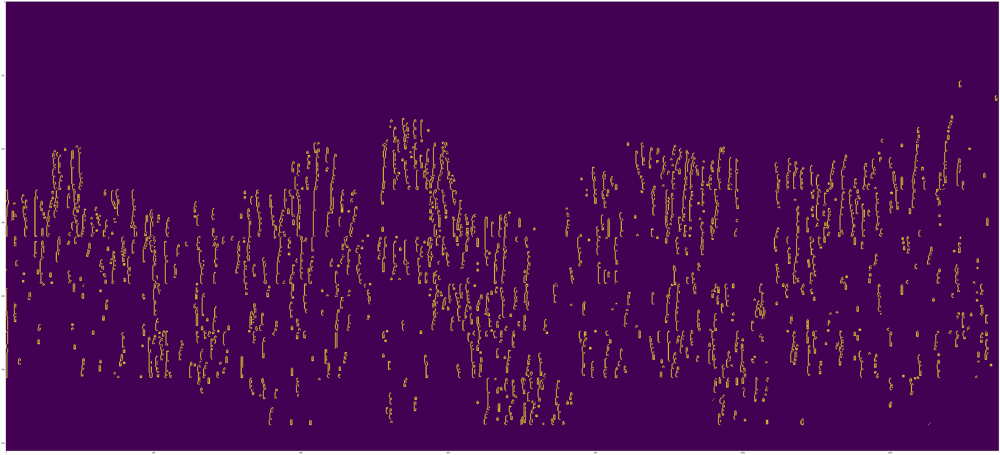

In [72]:
plt.figure(figsize=(100,80))
edges = cv2.Canny(img, 100, 500)

plt.imshow(edges/2)

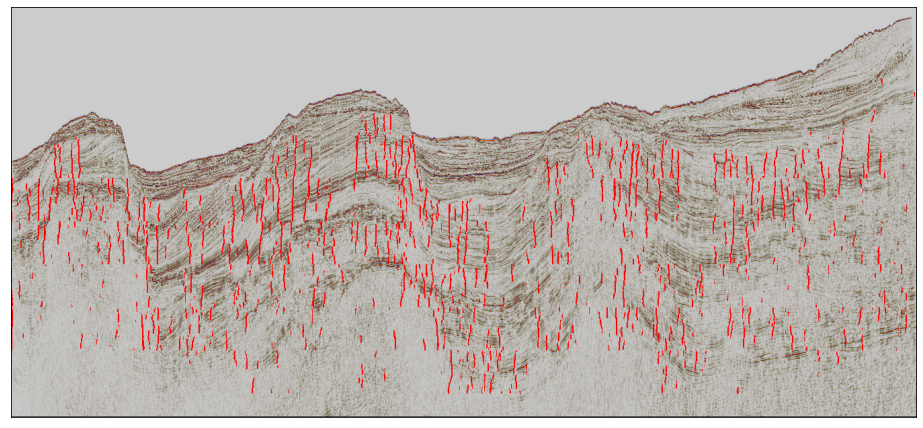

In [73]:
import cv2
import PIL
from PIL import Image
img = cv2.cvtColor(np.uint8(result/2*255), cv2.COLOR_BGR2GRAY)
edges = cv2.Canny(img, 200, 100)
lines = cv2.HoughLinesP(edges, rho=1, theta=0.5*np.pi/180, threshold=10, minLineLength=5, maxLineGap=50)
for l in lines:
    x1,x2,y1,y2 = l[0]
    cv2.line(np.uint8(result/2*255), (x1,y1), (x2,y2), (0,255,0), 3)

plt.figure(figsize=(100,80))
plot_overlay(data, result[:,:,0],i)


In [ ]:
dt = 64
dx = 64

# data, label = load_data_label(release_3)
# data = data[:700, :800]
# lable = label[:700, :800]
def load_data_label(sample):
    
    
    label = get_semantic_bitmap(sample['segmentation_bitmap'], sample['annotations'])
    label = np.stack([label==v for v in np.unique(label)], axis=-1)
    data = np.asarray(sample['image']) / 255.
    #converting to grayscale
#         data = 0.2989*data[:,:,0] + 0.5870*data[:,:,1] + 0.1140*data[:,:,2]
#         data = Image.open(data_dir + sample['file_name'])
    label = np.asarray(label)
    return data, label

plt.figure(figsize=(100,80))
seg = [3,4,5]
    
dataset = SegmentsDataset(release_n) 
# for i, sample in enumerate(dataset):
    
data, label = load_data_label(dataset[2])
(t_max, x_max, _) = data.shape

data_tiles, T, N   = tile(data, label, size, dt, dx, seg)
result_tiles = 1.*(model.predict_on_batch(data_tiles)>0.5)
result       = merge(result_tiles, t_max, x_max, size, dt, dx, T, N)
plot_overlay(data, result[:,:,0],i)
plt.xticks([])
plt.yticks([])

In [ ]:
x = 64

# data, label = load_data_label(release_3)
# data = data[:700, :800]
# lable = label[:700, :800]
def load_data_label(sample):
    
    label = get_semantic_bitmap(sample['segmentation_bitmap'], sample['annotations'])
    label = np.stack([label==v for v in np.unique(label)], axis=-1)
    data = np.asarray(sample['image']) / 255.
    #converting to grayscale
#         data = 0.2989*data[:,:,0] + 0.5870*data[:,:,1] + 0.1140*data[:,:,2]
#         data = Image.open(data_dir + sample['file_name'])
    label = np.asarray(label)
    return data, label

plt.figure(figsize=(100,80))
seg = [5]
    
dataset = SegmentsDataset(release_n) 
# for i, sample in enumerate(dataset):
    
data, label = load_data_label(dataset[8])
plot_overlay(data, label[:,:,5], 0)
plt.xticks([])
plt.yticks([])

In [ ]:
# dt = 64
# dx = 64

# data, label = load_data_label(release_3)
# # data = data[:700, :800]
# # lable = label[:700, :800]
# (t_max, x_max, _) = data.shape

# plt.figure(figsize=(80,50))
# seg = 4
    
# for i in range(1): 
#     data_tiles, T, N   = tile(data, label, size, dt, dx, seg)
#     result_tiles = 1.*(model.predict_on_batch(data_tiles)>0.25)
#     result       = merge(result_tiles, t_max, x_max, size, dt, dx, T, N)
#     plot_overlay(data, result[:,:,0],i)
#     plt.xticks([])
#     plt.yticks([])

In [ ]:
# dt = 64
# dx = 64

# data, label = load_data_label(release_1)
# # data = data[:700, :800]
# # lable = label[:700, :800]
# (t_max, x_max, _) = data.shape

# plt.figure(figsize=(80,50))
# seg = 5
    
# for i in range(1): 
#     data_tiles, T, N   = tile(data, label, size, dt, dx, seg)
#     result_tiles = 1.*(model.predict_on_batch(data_tiles)>0.5)
#     result       = merge(result_tiles, t_max, x_max, size, dt, dx, T, N)
#     plot_overlay(data, result[:,:,0],i)
#     plt.xticks([])
#     plt.yticks([])

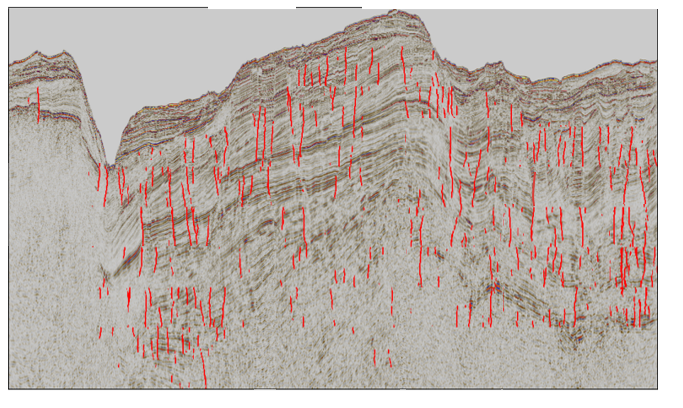


In [ ]:
# dt = 32
# dx = 32

# data, label = load_data_label(release_1)
# # data = data[:700, :800]
# # lable = label[:700, :800]
# (t_max, x_max, _) = data.shape

# plt.figure(figsize=(80,50))
# seg = 4
    
# for i in range(1): 
#     data_tiles, T, N   = tile(data, label, size, dt, dx,seg)
#     result_tiles = 1.*(model.predict_on_batch(data_tiles)>0.65)
#     result       = merge(result_tiles, t_max, x_max, size, dt, dx, T, N)
#     plot_overlay(data, result[:,:,0],i)
#     plt.xticks([])
#     plt.yticks([])

In [ ]:
# dt = 32
# dx = 32

# data, label = load_data_label(release_1)
# # data = data[:700, :800]
# # lable = label[:700, :800]
# (t_max, x_max, _) = data.shape

# plt.figure(figsize=(80,50))
# seg = 5
    
# for i in range(1): 
#     data_tiles, T, N   = tile(data, label, size, dt, dx,seg)
#     result_tiles = 1.*(model.predict_on_batch(data_tiles)>0.65)
#     result       = merge(result_tiles, t_max, x_max, size, dt, dx, T, N)
#     plot_overlay(data, result[:,:,0],i)
#     plt.xticks([])
#     plt.yticks([])

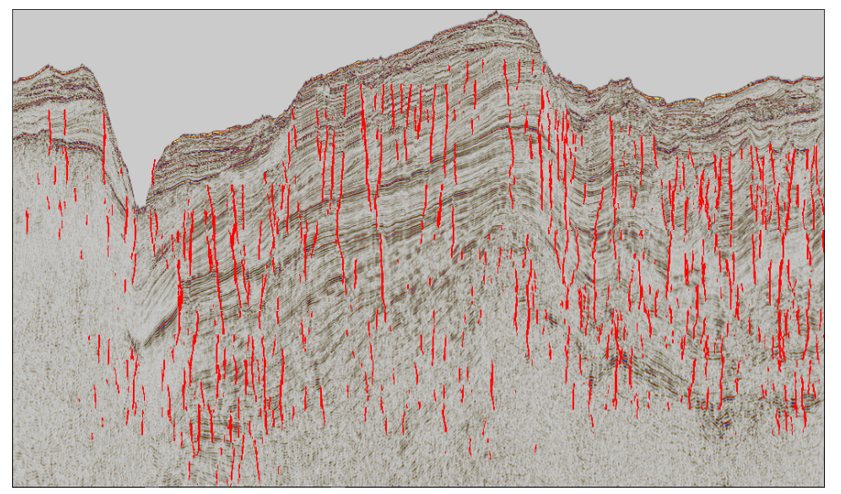

In [ ]:
# dt = 16
# dx = 16

# data, label = load_data_label(release_4)
# # data = data[:700, :800]
# # lable = label[:700, :800]
# (t_max, x_max, _) = data.shape

# plt.figure(figsize=(100,40))
# seg = 6
    
# for i in range(1): 
#     data_tiles, T, N   = tile(data, label, size, dt, dx,seg)
#     result_tiles = 1.*(model.predict_on_batch(data_tiles)>0.25)
#     result       = merge(result_tiles, t_max, x_max, size, dt, dx, T, N)
#     plot_overlay(data, result[:,:,0],i)
#     plt.xticks([])
#     plt.yticks([])

In [ ]:
def tile(data, wsize, dt, dx):
    
    (t_max, x_max, _) = data.shape    
    
    n_patch = (t_max//dt+1)*(x_max//dx+1)
    data_patch = np.zeros((n_patch,wsize,wsize,3)) 

    n = 0

    for t in range(0, t_max, dt):
        for x in range(0, x_max, dx):  
                if t_max - t < wsize and x_max - x < wsize:
                    data_patch[n,:,:,:] = data[t_max-wsize:t_max, x_max-wsize:x_max,:3]
                elif x_max - x < wsize:
                    data_patch[n,:,:,:] = data[t:t+wsize, x_max-wsize:x_max,:3]
                elif t_max - t < wsize:
                    data_patch[n,:,:,:] = data[t_max-wsize:t_max, x:x+wsize,:3]
                else:
                    data_patch[n,:,:,:] = data[t:t+wsize,x:x+wsize, :3]  
                n = n + 1

    return data_patch


def merge(data_patch, t_max, x_max, wsize, dt, dx):

    data_new = np.zeros((t_max, x_max,3))
    count = np.zeros((t_max, x_max, 1))
    
    n = 0
    for t in range(0, t_max, dt):
        for x in range(0, x_max, dx):
            if t_max - t < wsize and x_max - x < wsize:
                data_new[t_max-wsize:t_max, x_max-wsize:x_max,:] += data_patch[n, :,:,:]
                count[t_max-wsize:t_max, x_max-wsize:x_max,0] += 1
            elif x_max - x < wsize:
                data_new[t:t+wsize, x_max-wsize:x_max,:] += data_patch[n,:,:,:]
                count[t:t+wsize, x_max-wsize:x_max,0] += 1 
            elif t_max - t < wsize:
                data_new[t_max-wsize:t_max, x:x+wsize,:] += data_patch[n,:,:,:]
                count[t_max-wsize:t_max, x:x+wsize,0] += 1
            else:
                data_new[t:t+wsize,x:x+wsize,:] += data_patch[n,:,:,:]
                count[t:t+wsize,x:x+wsize,0] += 1 

            n = n + 1

    return data_new/count

def plot_overlay(image, label, i):
    (tmax, xmax) = np.shape(label)

    label_rgb = np.zeros((tmax,xmax,4), 'uint8')
    label_rgb[:,:,0] = 255
    label_rgb[:,:,1] = 255 - 255*label/np.max(label)
    label_rgb[:,:,2] = 255 - 255*label/np.max(label)
    label_rgb[:,:,3] = 255*label /np.max(label)  
    
    img = Image.fromarray(label_rgb, mode='RGBA')
    
    image_rgb = np.zeros((tmax,xmax,4), 'uint8')    
    image_rgb[:,:,0] = 255*image[:,:,0]
    image_rgb[:,:,1] = 255*image[:,:,1]
    image_rgb[:,:,2] = 255*image[:,:,2]
#     image_rgb[:,:,0:3] = 255. * image
    image_rgb[:,:,3] = 255
    
    background = Image.fromarray(image_rgb, mode='RGBA') 
    background.paste(img, (0, 0), img)

#     background = Image.fromarray(image_rgb, mode='RGBA') 
#     print(image.shape)
#     print(label.shape)
#     background.paste(label, (0, 0), label)

    plt.subplot(9,1,i+1).imshow(background)
    plt.xticks([])
    plt.yticks([])



In [ ]:
dt = 64
dx = 64

# data, label = load_data_label(release_3)
# data = data[:700, :800]
# lable = label[:700, :800]
def load_data_label(sample):
    
    
    label = get_semantic_bitmap(sample['segmentation_bitmap'], sample['annotations'])
#     label = np.stack([label==v for v in np.unique(label)], axis=-1)
    data = np.asarray(sample['image']) / 255.
    #converting to grayscale
#         data = 0.2989*data[:,:,0] + 0.5870*data[:,:,1] + 0.1140*data[:,:,2]
#         data = Image.open(data_dir + sample['file_name'])
    label = np.asarray(label)
    return data, label

plt.figure(figsize=(100,80))
    
sample = SegmentsDataset(release_1) 
# for i, sample in enumerate(dataset):
    
data, label = load_data_label(sample[0])
plot_overlay(data, label, 0)

(t_max, x_max, _) = data.shape

data_tiles = tile(data, size, dt, dx)
result_tiles = 1.*(model.predict_on_batch(data_tiles)>0.5)
result       = merge(result_tiles, t_max, x_max, size, dt, dx)
plot_overlay(data, result[:,:,0], 1)


In [ ]:
dt = 32
dx = 32

# data, label = load_data_label(release_3)
# data = data[:700, :800]
# lable = label[:700, :800]
def load_data_label(sample):
    
    
    label = get_semantic_bitmap(sample['segmentation_bitmap'], sample['annotations'])
#     label = np.stack([label==v for v in np.unique(label)], axis=-1)
    data = np.asarray(sample['image']) / 255.
    #converting to grayscale
#         data = 0.2989*data[:,:,0] + 0.5870*data[:,:,1] + 0.1140*data[:,:,2]
#         data = Image.open(data_dir + sample['file_name'])
    label = np.asarray(label)
    return data, label

plt.figure(figsize=(100,80))
    
sample = SegmentsDataset(release_1) 
# for i, sample in enumerate(dataset):
    
data, label = load_data_label(sample[0])
plot_overlay(data, label, 0)

(t_max, x_max, _) = data.shape

data_tiles = tile(data, size, dt, dx)
result_tiles = 1.*(model.predict_on_batch(data_tiles)>0.25)
result       = merge(result_tiles, t_max, x_max, size, dt, dx)
plot_overlay(data, result[:,:,0], 1)

In [ ]:
dt = 32
dx = 32

# data, label = load_data_label(release_3)
# data = data[:700, :800]
# lable = label[:700, :800]
def load_data_label(sample):
    
    
    label = get_semantic_bitmap(sample['segmentation_bitmap'], sample['annotations'])
#     label = np.stack([label==v for v in np.unique(label)], axis=-1)
    data = np.asarray(sample['image']) / 255.
    #converting to grayscale
#         data = 0.2989*data[:,:,0] + 0.5870*data[:,:,1] + 0.1140*data[:,:,2]
#         data = Image.open(data_dir + sample['file_name'])
    label = np.asarray(label)
    return data, label

plt.figure(figsize=(100,80))
    
sample = SegmentsDataset(release_7) 
# for i, sample in enumerate(dataset):
    
data, label = load_data_label(sample[0])
plot_overlay(data, label, 0)

(t_max, x_max, _) = data.shape

data_tiles = tile(data, size, dt, dx)
result_tiles = 1.*(model.predict_on_batch(data_tiles)>0.4)
result       = merge(result_tiles, t_max, x_max, size, dt, dx)
plot_overlay(data, result[:,:,0], 1)